In [1]:
import os
from os.path import join, exists, dirname
import cv2
import pickle
import pdb
from glob import glob
import numpy as np
from tqdm import tqdm
import matplotlib.pyplot as plt
%matplotlib inline
from joblib import Parallel, delayed
import multiprocessing as mp
# %pdb

In [2]:
root = "/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital"

In [3]:
babies = glob(root + "/*/*_joints.npy")
babies = [dirname(folder) for folder in babies]

In [4]:
len(babies)

841

In [5]:
def bbox_util(i, joints, img_name):
    j2 = joints[i]
    j2 = j2[np.where(j2[:, 2] != 0.0)]
    if len(j2) != 0:
        (minx, miny) = j2.min(axis=0)[:2]
        (maxx, maxy) = j2.max(axis=0)[:2]
        color = (255, 0, 0)
        top_left = np.array([minx, miny], dtype=np.float32)
        bot_right = np.array([maxx, maxy], dtype=np.float32)
        buffer = 0.15 * np.linalg.norm(bot_right - top_left)
        bbox = [top_left - buffer, bot_right + buffer]

        return bbox

In [6]:
for baby in tqdm(babies):
    joints = np.load(glob(baby + "/*_joints.npy")[0])
    for f in os.listdir(baby):
        if len(f.split('_')) == 6:
            img_folder = join(baby, f)
    images = sorted(glob(img_folder + "/*.jpg"))
    annotations = np.zeros((len(images), 4))
    
    bboxes = Parallel(n_jobs=1)(delayed(bbox_util)(i, joints, img_name) for i, img_name in enumerate(images))

    for i, bbox in enumerate(bboxes):
        if bbox is not None:
            annotations[i][0] = bbox[0][0]
            annotations[i][1] = bbox[0][1]
            annotations[i][2] = bbox[1][0]
            annotations[i][3] = bbox[1][1]

    bbox_file = img_folder + '_bbox.npy'
    np.save(bbox_file, annotations)

100%|██████████| 841/841 [03:14<00:00,  1.55it/s]


['/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591_joints.npy',
 '/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591',
 '/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591_masks',
 '/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591_skinmasks',
 '/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591_masked_ckb',
 '/scratch/data/readonly/real_data/unpaired/cleaned/anthrohospital/864303045715474_02082019081756/video_baby_cheeboard_ruler_1_5721153502451962591_rectified']

## Check annotations

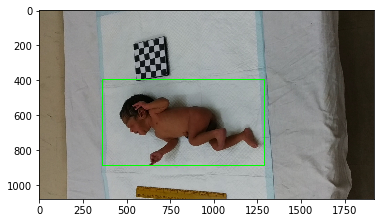

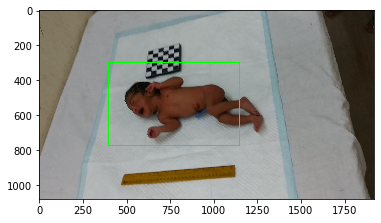

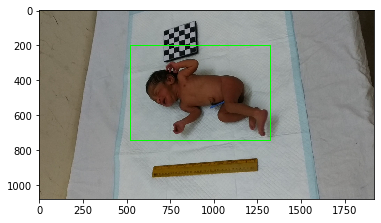

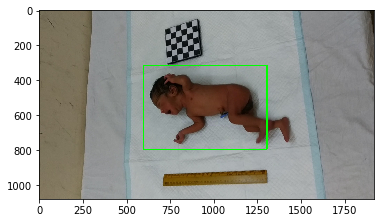

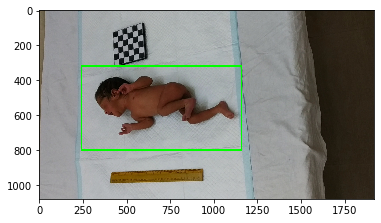

...

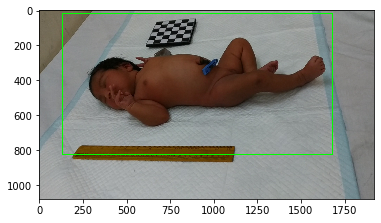

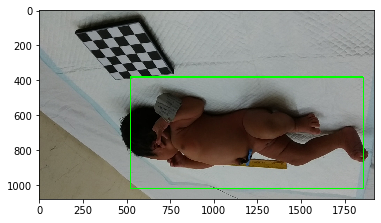

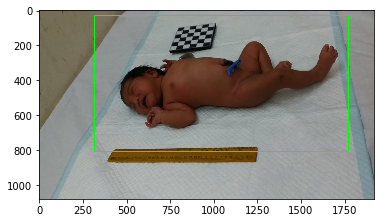

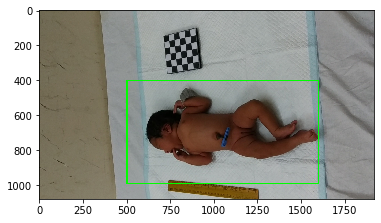

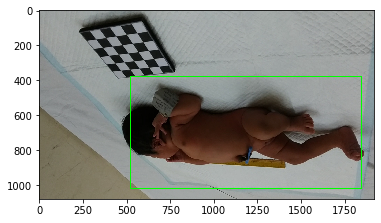

KeyboardInterrupt: 

In [6]:
for baby in babies:
    joints = np.load(glob(baby + "/*_joints.npy")[0])
    for f in os.listdir(baby):
        if len(f.split('_')) == 6:
            img_folder = join(baby, f)
    images = sorted(glob(img_folder + "/*.jpg"))
    bboxes = np.load(img_folder + "_bbox.npy")
    for i in range(10):
        k = np.random.randint(len(images))
        img_name = images[k]
        img = cv2.cvtColor(cv2.imread(img_name), cv2.COLOR_BGR2RGB)
        bbox = bboxes[k]
        img = cv2.rectangle(img, tuple([int(bbox[0]), int(bbox[1])]), tuple([int(bbox[2]), int(bbox[3])]), (0, 255, 0), 5)
        plt.imshow(img)
        plt.show()